# **Understanding the National Basketball Association (NBA)**
![link text](https://wallpaperaccess.com/full/1849421.jpg)






# **Research Question**
Are there more than just 5 positions in the NBA?

![link text](https://upload.wikimedia.org/wikipedia/commons/a/ac/Basketball_Positions.png)

# **Step 1: Get the Data**


*   NBA statistics data set on [Kaggle](https://www.kaggle.com/drgilermo/nba-players-stats)
*   NBA Salary information web-scrapped from [hoopshype.com](https://hoopshype.com/salaries/players/)




In [3]:
import pandas as pd
import numpy as np
df_stats = pd.read_csv("/content/drive/My Drive/Seasons_Stats.csv")
df_stats.head()

,Unnamed: 0,Year,Player,Pos,Age,Tm,G,GS,MP,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,blanl,OWS,DWS,WS,WS/48,blank2,OBPM,DBPM,BPM,VORP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
0,0,1950.0,Curly Armstrong,G-F,31.0,FTW,63.0,NaN,NaN,NaN,0.368,NaN,0.467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.1,3.6,3.5,NaN,NaN,NaN,NaN,NaN,NaN,144.0,516.0,0.279,NaN,NaN,NaN,144.0,516.0,0.279,0.279,170.0,241.0,0.705,NaN,NaN,NaN,176.0,NaN,NaN,NaN,217.0,458.0
1,1,1950.0,Cliff Barker,SG,29.0,INO,49.0,NaN,NaN,NaN,0.435,NaN,0.387,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.6,0.6,2.2,NaN,NaN,NaN,NaN,NaN,NaN,102.0,274.0,0.372,NaN,NaN,NaN,102.0,274.0,0.372,0.372,75.0,106.0,0.708,NaN,NaN,NaN,109.0,NaN,NaN,NaN,99.0,279.0
2,2,1950.0,Leo Barnhorst,SF,25.0,CHS,67.0,NaN,NaN,NaN,0.394,NaN,0.259,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.9,2.8,3.6,NaN,NaN,NaN,NaN,NaN,NaN,174.0,499.0,0.349,NaN,NaN,NaN,174.0,499.0,0.349,0.349,90.0,129.0,0.698,NaN,NaN,NaN,140.0,NaN,NaN,NaN,192.0,438.0
3,3,1950.0,Ed Bartels,F,24.0,TOT,15.0,NaN,NaN,NaN,0.312,NaN,0.395,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.5,-0.1,-0.6,NaN,NaN,NaN,NaN,NaN,NaN,22.0,86.0,0.256,NaN,NaN,NaN,22.0,86.0,0.256,0.256,19.0,34.0,0.559,NaN,NaN,NaN,20.0,NaN,NaN,NaN,29.0,63.0
4,4,1950.0,Ed Bartels,F,24.0,DNN,13.0,NaN,NaN,NaN,0.308,NaN,0.378,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.5,-0.1,-0.6,NaN,NaN,NaN,NaN,NaN,NaN,21.0,82.0,0.256,NaN,NaN,NaN,21.0,82.0,0.256,0.256,17.0,31.0,0.548,NaN,NaN,NaN,20.0,NaN,NaN,NaN,27.0,59.0


# **Step 2: Clean Data**



*   **Join** the salary table with the main data frame
*   **Add** all per game statistics and new Experience column
*   **Filter** the data to the past 10 years (in preperation for building the model)
*   Ensure that all columns are of the right data type





In [4]:
# Get the data with th joined Salary data set
df_sample = pd.read_csv("/content/drive/My Drive/df_sample.csv")
df_sample.head()

,Unnamed: 0,Year,Player,Pos,Age,Tm,G,GS,MP,PER,TS%,3PAr,FTr,ORB%,DRB%,TRB%,AST%,STL%,BLK%,TOV%,USG%,blanl,OWS,DWS,WS,WS/48,blank2,OBPM,DBPM,BPM,VORP,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,eFG%,FT,FTA,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,Experience,Salary,FGA/G,TRB/G,AST/G,STL/G,BLK/G,TOV/G,FG/G,3PA/G,3P/G,MP/G,PTS/G
0,19996,2010.0,Aaron Brooks,PG,25.0,HOU,82.0,82.0,2919.0,16.0,0.549,0.394,0.224,2.0,6.6,4.2,25.6,1.2,0.3,13.7,25.7,NaN,3.9,1.6,5.5,0.091,NaN,2.7,-2.5,0.2,1.6,575.0,1331.0,0.432,209.0,525.0,0.398,366.0,806.0,0.454,0.511,245.0,298.0,0.822,54.0,161.0,215.0,434.0,69.0,14.0,232.0,199.0,1604.0,3.0,1118520,16.232,2.622,5.293,0.841,0.171,2.829,7.012,6.402,2.549,35.598,19.561
1,20120,2010.0,Aaron Gray,C,25.0,TOT,32.0,0.0,311.0,16.6,0.551,0.000,0.341,16.7,23.1,19.8,10.6,1.5,2.7,16.0,16.4,NaN,0.5,0.4,0.9,0.142,NaN,-0.6,1.3,0.7,0.2,42.0,82.0,0.512,0.0,0.0,NaN,42.0,82.0,0.512,0.512,20.0,28.0,0.714,45.0,61.0,106.0,22.0,9.0,11.0,18.0,54.0,104.0,3.0,1000497,2.562,3.312,0.688,0.281,0.344,0.562,1.312,0.000,0.000,9.719,3.250
2,20121,2010.0,Aaron Gray,C,25.0,CHI,8.0,0.0,50.0,7.0,0.374,0.000,0.333,11.3,24.1,17.8,6.5,0.0,0.0,4.0,22.5,NaN,-0.1,0.1,0.0,-0.013,NaN,-6.6,-3.7,-10.2,-0.1,8.0,21.0,0.381,0.0,0.0,NaN,8.0,21.0,0.381,0.381,2.0,7.0,0.286,5.0,11.0,16.0,2.0,0.0,0.0,1.0,10.0,18.0,3.0,1000497,2.625,2.000,0.250,0.000,0.000,0.125,1.000,0.000,0.000,6.250,2.250
3,20122,2010.0,Aaron Gray,C,25.0,NOH,24.0,0.0,261.0,18.4,0.612,0.000,0.344,17.7,22.9,20.2,11.4,1.8,3.2,19.5,15.3,NaN,0.6,0.3,0.9,0.172,NaN,0.5,2.2,2.8,0.3,34.0,61.0,0.557,0.0,0.0,NaN,34.0,61.0,0.557,0.557,18.0,21.0,0.857,40.0,50.0,90.0,20.0,9.0,11.0,17.0,44.0,86.0,3.0,1000497,2.542,3.750,0.833,0.375,0.458,0.708,1.417,0.000,0.000,10.875,3.583
4,20248,2010.0,Acie Law,PG,25.0,TOT,26.0,1.0,234.0,16.0,0.585,0.213,0.653,1.4,6.6,4.1,17.5,2.3,0.4,15.0,21.7,NaN,0.3,0.2,0.6,0.115,NaN,-0.7,-2.5,-3.2,-0.1,35.0,75.0,0.467,5.0,16.0,0.313,30.0,59.0,0.508,0.500,38.0,49.0,0.776,3.0,14.0,17.0,26.0,11.0,1.0,17.0,16.0,113.0,3.0,2216160,2.885,0.654,1.000,0.423,0.038,0.654,1.346,0.615,0.192,9.000,4.346


# **Step 3: Visualize the Data**


In [0]:
df_classify = pd.read_csv("/content/drive/My Drive/df_classify")

In [16]:
from altair import *
Chart(df_classify).mark_bar().encode(
    X('Experience', title="Years in NBA"),
    Y('median(Salary):Q', title="Median Salary")
).properties(width=500,
             height=500,
             title="Salary by Years in the NBA").configure_axis(
                 titleFontSize=18,
                 labelFontSize=12
             )

alt.Chart(...)

The visualization above show the distribution of the median salary as player's years in the NBA increases. We can see the gradual increase as players gain more experience and then the decrease when players become too old.

The spike in the graph at year 20 is due to the fact that there is little data at these points and the players who played for that many years, Kevin Garnett and Kobe Bryant

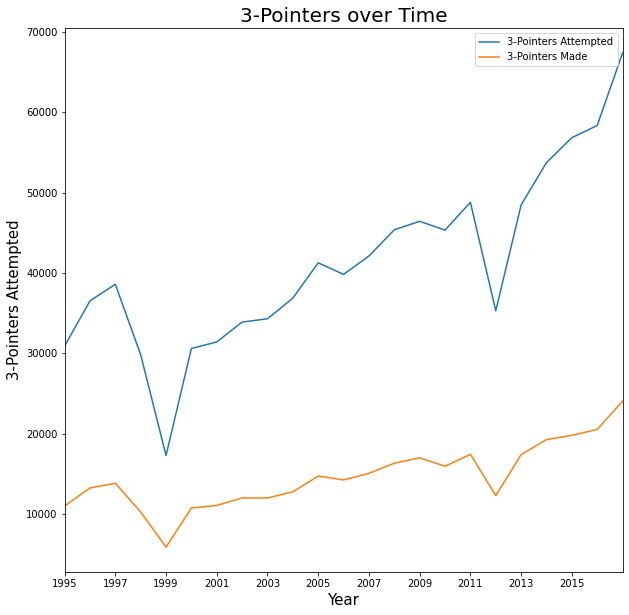

In [17]:
import matplotlib.pyplot as plt
df_1995 = pd.read_csv("/content/drive/My Drive/df_1995.csv")
plt.figure(figsize=(10,10))
df_1995.groupby("Year")["3PA"].sum().plot.line()

plt.title("3-Pointers over Time", size=20)
plt.xlabel("Year", size=15)
plt.ylabel("3-Pointers Attempted", size=15)
plt.xlim([1995, 2017])
plt.xticks(np.arange(1995, 2017, 2))

df_1995.groupby("Year")["3P"].sum().plot.line()
plt.legend(["3-Pointers Attempted", "3-Pointers Made"])

# **Step 4: Create Machine Learning Model**

**Type of Model**: Unsupervised Machine Learning with no true lables

**Outline of Model:** Use Principle Component Analysis and K-Means to create categories of NBA players

In [0]:
# Predictor to be used in the model
cols = ["Pos", "GS", "PER", "Experience",
        'TOV/G', 'OWS', 'DWS', "VORP",
        "FG%", "3P%", "FT%", "FGA/G", "TRB/G", "AST/G", "STL/G", "BLK/G",
        "3P/G", "PTS/G"]


## **First, use Principle Component Analysis (PCA)**
  Highlights of PCA:

*   Used for dimension reduction to only find significant predictors to use in the model
*   Does this by finding the most variance in the smallest amount of features
*   From the chart below, we can see a variance "drop-off" after the first two features. So we will use two features in our final machine learning model



![link text](data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAfgAAAFzCAYAAADSXxtkAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz%0AAAALEgAACxIB0t1+/AAAADh0RVh0U29mdHdhcmUAbWF0cGxvdGxpYiB2ZXJzaW9uMy4yLjAsIGh0%0AdHA6Ly9tYXRwbG90bGliLm9yZy8GearUAAAgAElEQVR4nO3de7xXdZ3v8dfH7YWMMhTqUSKCpuEd%0AcYuanSKLtBtqamA5qVPamDbdpjPW8ahD4xwtpzxOnpRJRqebmpeGPJpJqadJKS4mBqIiYsKUFyAM%0AUhP5nD9+a+PP7b4s9mbtvVn79Xw8fo+97r/Pb/mT92+t9V3fFZmJJEmql636uwBJkrT5GfCSJNWQ%0AAS9JUg0Z8JIk1ZABL0lSDRnwkiTV0Nb9XcDmMnz48Bw9enR/lyFJUp+ZN2/e05k5oqN5tQn40aNH%0AM3fu3P4uQ5KkPhMRj3U2z1P0kiTVkAEvSVINGfCSJNVQba7BS1IdvfDCCyxfvpznnnuuv0tRPxoy%0AZAgjR45km222Kb2OAS9JA9jy5ct5zWtew+jRo4mI/i5H/SAzWblyJcuXL2fMmDGl1/MUvSQNYM89%0A9xw77bST4T6IRQQ77bTTJp/FMeAlaYAz3NWT74ABL0nq0lvf+tZNWv7OO+/kAx/4AAAzZ87kwgsv%0A7HL5c889l1mzZnW5nZ4YPXo0Tz/9dI/X78wnPvEJFi1atNm3u7l5DV6StiDfuP2hzbq9z03as9tl%0A7r777h5vf/LkyUyePLnLZaZNm9bj7fe1F198kW9/+9v9XUYpHsFLkro0dOhQoHFEPXHiRI4//njG%0Ajh3LRz/6UTITgJ/85CeMHTuW8ePHc+ONN25c96qrruKss85izZo17LrrrmzYsAGAdevWscsuu/DC%0ACy9wyimncP3113e5nfPPP5+LL7544/i+++7LsmXLADjmmGM46KCD2GeffZg+fXqXn+Xyyy/ni1/8%0A4ivq62o7Q4cO5Qtf+AIHHHAA99xzDxMnTtzYc+oZZ5xBa2sr++yzD+edd97GdUaPHs15553H+PHj%0A2W+//Vi8eDEAa9eu5dRTT2W//fZj//3354YbbgDgpz/9KYcddhjjx4/nhBNOYO3atd3+d+mOAS9J%0AKu3ee+/lkksuYdGiRSxdupRf/vKXPPfcc5x22mn8+Mc/Zt68efzhD394xXo77LAD48aN46677gLg%0A5ptv5sgjj3zZbV9lttORGTNmMG/ePObOncull17KypUrO132uOOO46abbto4fu211zJ16tQut7Nu%0A3ToOOeQQ7rvvPt72tre9bHsXXHABc+fOZcGCBdx1110sWLBg47zhw4czf/58zjjjjI0/Tr7yla+w%0Aww47cP/997NgwQKOOOIInn76af7xH/+RWbNmMX/+fFpbW/n6179e6rN3xYCXJJU2YcIERo4cyVZb%0AbcW4ceNYtmwZixcvZsyYMeyxxx5EBCeddFKH606ZMoVrr70WgGuuuYYpU6a8bH7Z7bR36aWXcsAB%0AB3DooYfy+OOP8/DDD3e67IgRI9htt92YPXs2K1euZPHixRx++OFdbqelpYXjjjuuw+1dd911jB8/%0AngMPPJCFCxe+7Nr8hz70IQAOOuigjWcbZs2axZlnnrlxmWHDhjF79mwWLVrE4Ycfzrhx47j66qt5%0A7LFOu5gvzWvwkqTStttuu43DLS0trF+/vvS6kydP5stf/jKrVq1i3rx5HHHEEaXX3XrrrTee3gc2%0A3jJ25513MmvWLO655x623357Jk6c2O3tZFOnTuW6665j7NixHHvssUREl9sZMmQILS0tr9jOo48+%0AysUXX8ycOXMYNmwYp5xyysveu21fdbefMpNJkybxgx/8oPT+KMOA70LZxixlGqlIUl2NHTuWZcuW%0A8cgjj7D77rt3GlRDhw7l4IMP5jOf+Qwf+MAHXhGaXW1n9OjR3HzzzQDMnz+fRx99FIA1a9YwbNgw%0Att9+exYvXszs2bO7rffYY4/lggsu4N577+Wiiy7q8XaeeeYZXv3qV7PDDjvwxBNPcOuttzJx4sQu%0A15k0aRKXXXYZl1xyCQCrV6/m0EMP5cwzz2TJkiW8+c1vZt26daxYsYI99+xdtniKXpLUK0OGDGH6%0A9Om8//3vZ/z48bz+9a/vdNkpU6bw3e9+9xWn57vbznHHHceqVavYZ599+OY3v7kx/I466ijWr1/P%0AXnvtxdlnn82hhx7abb3Dhg1jr7324rHHHmPChAk93s4BBxzAgQceyNixY/nIRz6y8VR/V8455xxW%0Ar17NvvvuywEHHMAdd9zBiBEjuOqqqzjxxBPZf//9OeywwzY2yuuNaGsBuaVrbW3Nzf08eI/gJfW3%0ABx54gL322qu/y9AA0NF3ISLmZWZrR8t7BC9JUg0Z8JIk1VClAR8RR0XEgxGxJCLO7mD+5yNiUUQs%0AiIifRcSuTfNejIjfFK+ZVdYpSVLdVNaKPiJagMuAScByYE5EzMzM5g587wVaM/PPEXEG8FWgreXF%0As5k5rqr6JGlLkZk+cGaQ60l7uSqP4CcASzJzaWb+BbgGOLp5gcy8IzP/XIzOBkZWWI8kbXGGDBnC%0AypUre/QPvOqh7XnwQ4YM2aT1qrwPfmfg8abx5cAhXSz/ceDWpvEhETEXWA9cmJk/ar9CRJwOnA4w%0AatSoXhcsSQPNyJEjWb58OU899VR/l6J+NGTIEEaO3LRj4AHR0U1EnAS0Au9omrxrZq6IiN2An0fE%0A/Zn5SPN6mTkdmA6N2+T6rGBJ6iPbbLMNY8aM6e8ytAWq8hT9CmCXpvGRxbSXiYh3A/8DmJyZz7dN%0Az8wVxd+lwJ3AgRXWKklSrVQZ8HOAPSJiTERsC0wFXtYaPiIOBK6gEe5PNk0fFhHbFcPDgcOB5sZ5%0AkiSpC5Wdos/M9RFxFnAb0ALMyMyFETENmJuZM4GvAUOBHxYtRH+XmZOBvYArImIDjR8hF7ZrfS9J%0AkrpQ6TX4zLwFuKXdtHObht/dyXp3A/tVWZskSXVmT3aSJNWQAS9JUg0Z8JIk1ZABL0lSDRnwkiTV%0AkAEvSVINGfCSJNWQAS9JUg0Z8JIk1ZABL0lSDRnwkiTVkAEvSVINGfCSJNWQAS9JUg0Z8JIk1ZAB%0AL0lSDRnwkiTVkAEvSVINGfCSJNWQAS9JUg0Z8JIk1ZABL0lSDRnwkiTVkAEvSVINGfCSJNWQAS9J%0AUg0Z8JIk1ZABL0lSDRnwkiTVkAEvSVINGfCSJNWQAS9JUg0Z8JIk1ZABL0lSDRnwkiTVkAEvSVIN%0AGfCSJNWQAS9JUg0Z8JIk1ZABL0lSDRnwkiTVkAEvSVINGfCSJNWQAS9JUg0Z8JIk1ZABL0lSDRnw%0AkiTVkAEvSVINGfCSJNWQAS9JUg0Z8JIk1VClAR8RR0XEgxGxJCLO7mD+5yNiUUQsiIifRcSuTfNO%0AjoiHi9fJVdYpSVLdVBbwEdECXAa8F9gbODEi9m632L1Aa2buD1wPfLVYd0fgPOAQYAJwXkQMq6pW%0ASZLqpsoj+AnAksxcmpl/Aa4Bjm5eIDPvyMw/F6OzgZHF8JHA7Zm5KjNXA7cDR1VYqyRJtVJlwO8M%0APN40vryY1pmPA7f2cF1JktRk6/4uACAiTgJagXds4nqnA6cDjBo1qoLKJEnaMlV5BL8C2KVpfGQx%0A7WUi4t3A/wAmZ+bzm7JuZk7PzNbMbB0xYsRmK1ySpC1dlQE/B9gjIsZExLbAVGBm8wIRcSBwBY1w%0Af7Jp1m3AeyJiWNG47j3FNEmSVEJlp+gzc31EnEUjmFuAGZm5MCKmAXMzcybwNWAo8MOIAPhdZk7O%0AzFUR8RUaPxIApmXmqqpqlSSpbiq9Bp+ZtwC3tJt2btPwu7tYdwYwo7rqJEmqL3uykySphgx4SZJq%0AyICXJKmGDHhJkmrIgJckqYYMeEmSasiAlySphgx4SZJqyICXJKmGDHhJkmrIgJckqYYMeEmSasiA%0AlySphgx4SZJqyICXJKmGDHhJkmrIgJckqYYMeEmSasiAlySphgx4SZJqyICXJKmGDHhJkmqo24CP%0AhpMi4txifFRETKi+NEmS1FNljuD/D3AYcGIx/ifgssoqkiRJvbZ1iWUOyczxEXEvQGaujohtK65L%0AkiT1Qpkj+BciogVIgIgYAWyotCpJktQrZQL+UuAm4PURcQHwn8A/VVqVJEnqlW5P0Wfm9yJiHvAu%0AIIBjMvOByiuTJEk91m3AR8SOwJPAD5qmbZOZL1RZmCRJ6rkyp+jnA08BDwEPF8PLImJ+RBxUZXGS%0AJKlnygT87cD7MnN4Zu4EvBe4GfgUjVvoJEnSAFMm4A/NzNvaRjLzp8BhmTkb2K6yyiRJUo+VuQ/+%0A9xHx98A1xfgU4Mni1jlvl5MkaQAqcwT/EWAk8CMat8vtAkwFWoAPV1eaJEnqqTJH8O/MzE83T4iI%0AEzLzh8CSasqSJEm9UeYI/kslp0mSpAGi0yP4iHgv8D5g54i4tGnWa4H1VRcmSZJ6rqtT9P8FzAUm%0AA/Oapv8J+FyVRUmSpN7pNOAz8z7gvoj4vr3WSZK0ZSnTyG50RPwvYG9gSNvEzNytsqokSVKvlGlk%0A92/At2hcd38n8O/Ad6ssSpIk9U6ZgH9VZv4MiMx8LDPPB95fbVmSJKk3ypyifz4itgIejoizgBXA%0A0GrLkiRJvVHmCP4zwPbA3wIHAScBH6uyKEmS1DtlAn50Zq7NzOWZeWpmHgeMqrowSZLUc/ZkJ0lS%0ADdmTnSRJNWRPdpIk1ZA92UmSVENlbpObEBHnA7sWyweQ9mQnSdLAVSbgr6RxSn4e8GK15UiSpM2h%0ATMCvycxbK69EkiRtNmVuk7sjIr4WEYdFxPi2V5mNR8RREfFgRCyJiLM7mP/2iJgfEesj4vh2816M%0AiN8Ur5klP48kSaLcEfwhxd/WpmkJHNHVShHRAlwGTAKWA3MiYmZmLmpa7HfAKcDfdbCJZzNzXIn6%0AJElSO90GfGa+s4fbngAsycylABFxDXA0sDHgM3NZMW9DD99DkiR1oNtT9BHxhoi4MiJuLcb3joiP%0Al9j2zsDjTePLi2llDYmIuRExOyKO6aS204tl5j711FObsGlJkuqtzDX4q4DbgDcV4w8Bn62qoCa7%0AZmYr8BHgkojYvf0CmTk9M1szs3XEiBF9UJIkSVuGMgE/PDOvAzYAZOZ6yt0utwLYpWl8ZDGtlMxc%0AUfxdCtwJHFh2XUmSBrsyAb8uInai0bCOiDgUWFNivTnAHhExJiK2BaYCpVrDR8SwiNiuGB4OHE7T%0AtXtJktS1Mq3oP08jmHePiF8CI4Dju16lcaQfEWfROL3fAszIzIURMQ2Ym5kzI+Jg4CZgGPDBiPiH%0AzNwH2Au4omh8txVwYbvW95IkqQtlWtHPj4h3AG+h0U3tg2X7ps/MW4Bb2k07t2l4Do1T9+3XuxvY%0Ar8x7SJKkVyrTiv5MYGhmLszM3wJDI+JT1ZcmSZJ6qsw1+NMy849tI5m5GjitupIkSVJvlQn4loiI%0AtpGih7ptqytJkiT1VplGdrcB10bEFcX4J4GfVFeSJEnqrTIB/0UaoX5GMX478O3KKpIkSb3WZcAX%0Ap+MXZuZY4PK+KUmSJPVWl9fgM/NF4MGIGNVH9UiSpM2gzCn6YcDCiPg1sK5tYmZOrqwqSZLUK2UC%0A/n9WXoUkSdqsyvRkd1dE7ArskZmzImJ7Gl3PSpKkAapMT3anAdcDbbfJ7Qz8qMqiJElS75Tp6OZM%0AGk9zewYgMx8GXl9lUZIkqXfKBPzzmfmXtpGI2Jri0bGSJGlgKhPwd0XEl4FXRcQk4IfAj6stS5Ik%0A9UaZgD8beAq4n0aPdrcA51RZlCRJ6p0yreg3RMTVwK9onJp/MDM9RS9J0gDWbcBHxPtpdFP7CBDA%0AmIj4ZGbeWnVxkiSpZ8p0dPPPwDszcwlAROwO/F/AgJckaYAqcw3+T23hXlgK/KmieiRJ0mZQ5gh+%0AbkTcAlxH4xr8CcCciPgQQGbeWGF9kiSpB8oE/BDgCeAdxfhTwKuAD9IIfANekqQBpkwr+lP7ohBJ%0AkrT5lLkGL0mStjAGvCRJNWTAS5JUQ2UeF/uGiLgyIm4txveOiI9XX5okSeqpMkfwVwG3AW8qxh8C%0APltVQZIkqffKBPzwzLwO2ACQmeuBFyutSpIk9UqZgF8XETtRPAM+Ig4F1lRalSRJ6pUyHd18HpgJ%0A7B4RvwRGAMdXWpUkSeqVMh3dzI+IdwBvofE0uQcz84XKK5MkST1WphX9mcDQzFyYmb8FhkbEp6ov%0ATZIk9VSZa/CnZeYf20YyczVwWnUlSZKk3ioT8C0REW0jEdECbFtdSZIkqbfKNLL7CXBtRFxRjH+y%0AmCZJkgaoMgH/9zRC/Yxi/Hbg25VVJEmSeq1MK/oNwLeKlyRJ2gJ0G/ARcThwPrBrsXwAmZm7VVua%0AJEnqqTKn6K8EPgfMwy5qJUnaIpQJ+DWZeWvllUiSpM2mTMDfERFfA24Enm+bmJnzK6tKkiT1SpmA%0AP6T429o0LYEjNn85kiRpcyjTiv6dfVGIJEnafMocwRMR7wf2AYa0TcvMaVUVJUmSeqfMw2YuB6YA%0An6Zxi9wJNG6ZkyRJA1SZvujfmpkfA1Zn5j8AhwF7VluWJEnqjTIB/2zx988R8SbgBeCN1ZUkSZJ6%0Aq8w1+Jsj4nXA14D5NFrQ2xd9J75x+0OllvvcJE+CSJKqU6YV/VeKwRsi4mZgSGauqbYsSZLUG50G%0AfEQckZk/j4gPdTCPzLyx2tIkSVJPdXUE/w7g58AHO5iXNHq2kyRJA1Cnjewy87yI2Aq4NTNPbff6%0A6zIbj4ijIuLBiFgSEWd3MP/tETE/ItZHxPHt5p0cEQ8Xr5M3+ZNJkjSIddmKvngW/H/vyYYjogW4%0ADHgvsDdwYkTs3W6x3wGnAN9vt+6OwHk0usmdAJwXEcN6UockSYNRmdvkZkXE30XELhGxY9urxHoT%0AgCWZuTQz/wJcAxzdvEBmLsvMBcCGduseCdyemasyczVwO3BUifeUJEmUu01uSvH3zKZpCezWzXo7%0AA483jS/npQfXdKejdXcuua4kSYNemdvkxvRFIT0REacDpwOMGjWqn6uRJGngKPuwmX1pXEdvftjM%0Av3ez2gpgl6bxkcW0MlYAE9ute2f7hTJzOjAdoLW1NUtuW5Kk2ivzsJnzgH8pXu8EvgpMLrHtOcAe%0AETEmIrYFpgIzS9Z1G/CeiBhWNK57TzFNkiSVUKaR3fHAu4A/ZOapwAHADt2tlJnrgbNoBPMDwHWZ%0AuTAipkXEZICIODgiltN4Qt0VEbGwWHcV8BUaPxLmANOKaZIkqYQyp+ifzcwNxb3qrwWe5OWn3juV%0AmbcAt7Sbdm7T8Bwap987WncGMKPM+0iSpJcrE/Bzi4fN/CswD1gL3FNpVZIkqVe66ov+MuD7mfmp%0AYtLlEfET4LXFveuSJGmA6uoI/iHg4oh4I3Ad8IPMvLdvypIkSb3RVV/0/zszD6Px0JmVwIyIWBwR%0A50WEDzOXJGkA67YVfWY+lpkXZeaBwInAMTRaxUuSpAGqzH3wW0fEByPie8CtwIPAK54RL0mSBo6u%0AGtlNonHE/j7g1zQeFnN6Zq7ro9okSVIPddXI7ks0HuP6heKJbpIkaQvRacBn5hF9WYgkSdp8ynRV%0AK0mStjAGvCRJNWTAS5JUQwa8JEk1ZMBLklRDBrwkSTVkwEuSVEMGvCRJNWTAS5JUQwa8JEk1ZMBL%0AklRDBrwkSTVkwEuSVEMGvCRJNWTAS5JUQwa8JEk1ZMBLklRDBrwkSTVkwEuSVEMGvCRJNWTAS5JU%0AQwa8JEk1ZMBLklRDBrwkSTVkwEuSVEMGvCRJNWTAS5JUQwa8JEk1ZMBLklRDBrwkSTVkwEuSVEMG%0AvCRJNWTAS5JUQwa8JEk1ZMBLklRDBrwkSTVkwEuSVEMGvCRJNWTAS5JUQwa8JEk1ZMBLklRDBrwk%0ASTVkwEuSVEOVBnxEHBURD0bEkog4u4P520XEtcX8X0XE6GL66Ih4NiJ+U7wur7JOSZLqZuuqNhwR%0ALcBlwCRgOTAnImZm5qKmxT4OrM7MN0fEVOAiYEox75HMHFdVfZIk1VmVR/ATgCWZuTQz/wJcAxzd%0AbpmjgauL4euBd0VEVFiTJEmDQmVH8MDOwONN48uBQzpbJjPXR8QaYKdi3piIuBd4BjgnM3/R/g0i%0A4nTgdIBRo0Zt3ur70Dduf6j0sp+btGeFlUiS6mKgNrL7PTAqMw8EPg98PyJe236hzJyema2Z2Tpi%0AxIg+L1KSpIGqyoBfAezSND6ymNbhMhGxNbADsDIzn8/MlQCZOQ94BPDQVZKkkqoM+DnAHhExJiK2%0ABaYCM9stMxM4uRg+Hvh5ZmZEjCga6RERuwF7AEsrrFWSpFqp7Bp8cU39LOA2oAWYkZkLI2IaMDcz%0AZwJXAt+JiCXAKho/AgDeDkyLiBeADcDfZOaqqmqVJKluqmxkR2beAtzSbtq5TcPPASd0sN4NwA1V%0A1iZJUp0N1EZ2kiSpFwx4SZJqyICXJKmGDHhJkmqo0kZ2qo6930mSumLADyL+KJCkwcNT9JIk1ZAB%0AL0lSDRnwkiTVkNfg1a2y1+69bi9JA4dH8JIk1ZABL0lSDRnwkiTVkAEvSVINGfCSJNWQrehViZ60%0AvLenPUnafAx4bdF68qOgpz8kqvzR0lfrNK/nDyqp3gx4SaX5o0DacngNXpKkGjLgJUmqIQNekqQa%0AMuAlSaohA16SpBoy4CVJqiFvk5NUOR85LPU9j+AlSaohA16SpBoy4CVJqiEDXpKkGrKRnaQByYZ5%0AUu94BC9JUg0Z8JIk1ZABL0lSDXkNXlJteN1eeokBL2lQK/ujAPxhoC2Lp+glSaohA16SpBoy4CVJ%0AqiEDXpKkGjLgJUmqIQNekqQa8jY5SdpE3lqnLYEBL0l9wB8F6msGvCQNYPbOp57yGrwkSTXkEbwk%0A1YxH/QKP4CVJqiWP4CVJNgKsIQNektQj/igY2Ax4SVKf8UdB3/EavCRJNVRpwEfEURHxYEQsiYiz%0AO5i/XURcW8z/VUSMbpr3pWL6gxFxZJV1SpJUN5Wdoo+IFuAyYBKwHJgTETMzc1HTYh8HVmfmmyNi%0AKnARMCUi9gamAvsAbwJmRcSemfliVfVKkgamnp7WH+y3C1Z5BD8BWJKZSzPzL8A1wNHtljkauLoY%0Avh54V0REMf2azHw+Mx8FlhTbkyRJJVQZ8DsDjzeNLy+mdbhMZq4H1gA7lVxXkiR1IjKzmg1HHA8c%0AlZmfKMb/CjgkM89qWua3xTLLi/FHgEOA84HZmfndYvqVwK2ZeX279zgdOL0YfQvwYCUf5uWGA0/3%0AwfsMdO6HBvdDg/uhwf3gPmjTV/th18wc0dGMKm+TWwHs0jQ+spjW0TLLI2JrYAdgZcl1yczpwPTN%0AWHO3ImJuZrb25XsORO6HBvdDg/uhwf3gPmgzEPZDlafo5wB7RMSYiNiWRqO5me2WmQmcXAwfD/w8%0AG6cUZgJTi1b2Y4A9gF9XWKskSbVS2RF8Zq6PiLOA24AWYEZmLoyIacDczJwJXAl8JyKWAKto/Aig%0AWO46YBGwHjjTFvSSJJVXaU92mXkLcEu7aec2DT8HnNDJuhcAF1RZXw/16SWBAcz90OB+aHA/NLgf%0A3Adt+n0/VNbITpIk9R+7qpUkqYYM+E3QXde7g0VELIuI+yPiNxExt7/r6SsRMSMinixu72ybtmNE%0A3B4RDxd/h/VnjVXrZB+cHxEriu/DbyLiff1ZY1+IiF0i4o6IWBQRCyPiM8X0wfZ96Gw/DKrvREQM%0AiYhfR8R9xX74h2L6mKIb9iVFt+zb9mldnqIvp+h69yGaut4FTmzX9e6gEBHLgNbMHFT3ukbE24G1%0AwL9n5r7FtK8CqzLzwuJH37DM/Pv+rLNKneyD84G1mXlxf9bWlyLijcAbM3N+RLwGmAccA5zC4Po+%0AdLYfPswg+k4UPbC+OjPXRsQ2wH8CnwE+D9yYmddExOXAfZn5rb6qyyP48sp0vasay8z/R+Nuj2bN%0A3S1fTeMft9rqZB8MOpn5+8ycXwz/CXiARm+bg+370Nl+GFSyYW0xuk3xSuAIGt2wQz98Hwz48uw+%0A9yUJ/DQi5hW9CQ5mb8jM3xfDfwDe0J/F9KOzImJBcQq/1qel2yuegnkg8CsG8feh3X6AQfadiIiW%0AiPgN8CRwO/AI8MeiG3boh8ww4NUTb8vM8cB7gTOL07aDXtFJ02C85vUtYHdgHPB74J/7t5y+ExFD%0AgRuAz2bmM83zBtP3oYP9MOi+E5n5YmaOo9Hz6gRgbD+XZMBvglLd5w4Gmbmi+PskcBOD+0l/TxTX%0AIduuRz7Zz/X0ucx8ovjHbQPwrwyS70NxrfUG4HuZeWMxedB9HzraD4P1OwGQmX8E7gAOA15XdMMO%0A/ZAZBnx5Zbrerb2IeHXRmIaIeDXwHuC3Xa9Va83dLZ8M/Ec/1tIv2gKtcCyD4PtQNKq6EnggM7/e%0ANGtQfR862w+D7TsRESMi4nXF8KtoNMZ+gEbQH18s1uffB1vRb4LiVo9LeKnr3YHY016lImI3Gkft%0A0OgJ8fuDZT9ExA+AiTSeEvUEcB7wI+A6YBTwGPDhzKxtI7RO9sFEGqdiE1gGfLLpOnQtRcTbgF8A%0A9wMbislfpnH9eTB9HzrbDycyiL4TEbE/jUZ0LTQOnK/LzGnFv5fXADsC9wInZebzfVaXAS9JUv14%0Ail6SpBoy4CVJqiEDXpKkGjLgJUmqIQNekqQaMuClPhYRLxZP2PptRPwwIrbvZLm7e7j91oi4tBf1%0Are1+qS1fRHy2s30v1YG3yUl9LCLWZubQYvh7wLx2nYRs3dR/db/WV2eD9amIGjw8gpf61y+AN0fE%0AxIj4RUTMBBbBS0fSxbw7I+L6iFgcEd8rehAjIg6OiLuL51D/OiJeUyx/czH//Ij4TkTcUzyj/LRi%0A+tCI+FlEzI+I+yOi2ycjRsTHioeH3BcR3ymmjY6InxfTfxYRo4rpV0XEtyJidkQsLWqaEREPRMRV%0ATdtcGxHfiMYztH8WESOK6eOKdRdExE1tDysp9sNFxWd9KCL+WzG9JSK+FhFzinU+2dW+i4i/Bd4E%0A3BGN55m3FDX/ttgfn9sM/22l/pWZvnz56sMXjedkQ6MnwP8AzqDRG9w6YEwHy00E1tDoy3or4B7g%0AbcC2wFLg4GK51xbbnAjcXA8kbAMAAALgSURBVEw7H7gPeBWN3ucepxFsWwOvLZYZDizhpTN6azuo%0AeR/gIWB4Mb5j8ffHwMnF8F8DPyqGr6LRg1fQeITqM8B+Rf3zgHHFcgl8tBg+F/hmMbwAeEcxPA24%0ApBi+E/jnYvh9wKxi+HTgnGJ4O2AuMKazfVcst6zp8xwE3N70eV/X398TX756+/IIXup7r4rGYyXn%0AAr+j0Zc3wK8z89FO1vl1Zi7PxsM7fgOMBt4C/D4z5wBk5jPZ8an9/8jMZ7NxKvoOGg/+COCfImIB%0AMIvGYyy7erTpEcAPi22QL3W/ehjw/WL4OzR+eLT5cWYmjW5Mn8jM+4v6Fxb1Q6N702uL4e8Cb4uI%0AHWgE7F3F9KuB5icWtj3YZV7Tdt4DfKzYr78CdgL2KOZ1tO/aWwrsFhH/EhFH0fhBIm3Rtu5+EUmb%0A2bPZeKzkRsUZ93VdrNPcf/WLbNr/u+0b2iTwUWAEcFBmvlBcjx6yCdsso63mDby8/g10Xn+ZRkFt%0A22reDwF8OjNva14wIiZSYt9l5uqIOAA4Evgb4MM0zkhIWyyP4KUt14PAGyPiYIDi+ntHwXl0RAyJ%0AiJ1onLKeA+wAPFmE+zuBXbt5r58DJxTbICJ2LKbfTePJitD40fCLTfwMW/HS07Y+AvxnZq4BVrdd%0AXwf+Criro5Wb3AacEY1HlxIRe0bjaYdd+RPQ9mTE4cBWmXkDcA4wfhM/hzTgeAQvbaEy8y8RMQX4%0Al2g8ovJZ4N0dLLqAxqn54cBXMvO/itb7P46I+2lcKljczXstjIgLgLsi4kUaT8Y6Bfg08G8R8UXg%0AKeDUTfwY64AJEXEOjWenTymmnwxcXtzGtrTEdr9N49T7/KIB4lPAMd2sMx34SUT8F/DZ4nO0HfR8%0AaRM/hzTgeJucVGMRcT6NRnMX93ctHRkst+RJ/cFT9JIk1ZBH8JIk1ZBH8JIk1ZABL0lSDRnwkiTV%0AkAEvSVINGfCSJNWQAS9JUg39f5tJnykjSGxuAAAAAElFTkSuQmCC)

## **Second, Use K-Means and Find Number of "k" Clusters**

**Find "k" Clusters:** Scikit Learn defines **inertia** to be the "Sum of squared distances of samples to their closest cluster center". Thus, **inertia** gives us a measure of how well each cluster is grouped together

![link text](data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAZEAAAEGCAYAAACkQqisAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz%0AAAALEgAACxIB0t1+/AAAADh0RVh0U29mdHdhcmUAbWF0cGxvdGxpYiB2ZXJzaW9uMy4yLjAsIGh0%0AdHA6Ly9tYXRwbG90bGliLm9yZy8GearUAAAgAElEQVR4nO3de3hU5bn38e9NAkKQYwjKKQn1hEIV%0AMUV04pEWT61Aa3drU6FuNW9ftba1+3ql0ta2lm5buzebHraVSiu2EWsVBbxqKVrPyiEcFBAtqEnk%0AoKCgAaIi5H7/mCd0CAkkk5msJPP7XNdcs+aZNc/cE0h+s9az1rPM3REREUlGp6gLEBGR9kshIiIi%0ASVOIiIhI0hQiIiKSNIWIiIgkLTvqAlpbv379vLCwMOoyRETajeXLl7/j7nkNPZdxIVJYWEh5eXnU%0AZYiItBtmVtnYc9qdJSIiSVOIiIhI0tIaImZWYWarzWyVmZWHtr5mtsjM1of7PqHdzOyXZrbBzF4y%0As1EJ/UwO6683s8kJ7aeF/jeE11o6P4+IiByoNbZEznP3ke5eFB5PAR539+OAx8NjgIuA48KtFLgD%0A4qED3AKcDowGbqkLnrDONQmvuzD9H0dEROpEsTtrPDA7LM8GJiS03+Nxi4HeZjYAuABY5O7b3X0H%0AsAi4MDzX090Xe3wCsHsS+hIRkVaQ7hBx4O9mttzMSkPbUe6+JSy/BRwVlgcBbya8dmNoO1T7xgba%0AD2JmpWZWbmbl27Zta/aHKCsro7CwkE6dOlFYWEhZWVmz+xAR6YjSfYhvsbtvMrP+wCIzeyXxSXd3%0AM0v7NMLuPhOYCVBUVNSs9ysrK6O0tJSamhoAKisrKS2N52FJSUmKKxURaV/SuiXi7pvC/VbgIeJj%0AGm+HXVGE+61h9U3AkISXDw5th2of3EB7Sk2dOnV/gNSpqalh6tSpqX4rEZF2J20hYmbdzaxH3TIw%0ADlgDzAfqjrCaDMwLy/OBSeEorTHA+2G310JgnJn1CQPq44CF4blqMxsTjsqalNBXylRVVTWrXUQk%0Ak6Rzd9ZRwEPhqNts4F53/5uZLQPuN7OrgErg38L6fwUuBjYANcCVAO6+3cxuBZaF9X7s7tvD8rXA%0A3UA34NFwS6n8/HwqKw8+WTM/Pz/VbyUi0u5Ypl3ZsKioyJsz7Un9MRGAnJwcZs6cqTEREckIZrY8%0A4TSNA+iM9cMoKSlh5syZHHVU/CCyvLw8BYiISKAQaYKSkhIqKys54ogjuOKKKxQgIiKBQqSJjjji%0ACD71qU/x3HPPRV2KiEiboRBphlgsxooVK/jggw+iLkVEpE1QiDRDLBbj448/ZtmyZYdfWUQkAyhE%0AmuHMM88E4Nlnn424EhGRtkEh0gy5ubmceOKJGhcREQkUIs0Ui8V4/vnnqa2tjboUEZHIKUSaqbi4%0AmPfee49169ZFXYqISOQUIs0Ui8UAjYuIiIBCpNmOOeYY+vfvr3EREREUIs1mZsRiMYWIiAgKkaQU%0AFxfz+uuvs2XLlsOvLCLSgSlEklA3LqKtERHJdAqRJJx66ql07dpVISIiGU8hkoQuXbowevRohYiI%0AZDyFSJKKi4tZsWIFu3fvjroUEZHIKESSFIvF2LdvH0uXLo26FBGRyChEknTGGWcAGlwXkcymEElS%0Anz59GDFihEJERDKaQqQF6iZj3LdvX9SliIhEQiHSArFYjOrqatauXRt1KSIikVCItIBOOhSRTKcQ%0AaYGhQ4cyYMAAzegrIhlLIdICmoxRRDKdQqSFYrEYlZWVbNq0KepSRERanUKkhTQuIiKZTCHSQiNH%0AjiQnJ0fjIiKSkRQiLdS5c2dOP/10bYmISEZSiKRALBZj1apV7Ny5M+pSRERalUIkBYqLi6mtrWXJ%0AkiVRlyIi0qoUIikwZswYzEy7tEQk4yhEUqBXr1588pOfVIiISMZRiKRILBbjhRdeYO/evVGXIiLS%0AahQiKVJcXMyuXbtYvXp11KWIiLSatIeImWWZ2UozeyQ8HmpmS8xsg5n92cy6hPYjwuMN4fnChD6+%0AG9pfNbMLEtovDG0bzGxKuj/LoeikQxHJRK2xJfJNYF3C458B0939WGAHcFVovwrYEdqnh/Uws5OA%0ALwPDgQuB/w3BlAX8BrgIOAm4PKwbifz8fAYNGqQQEZGMktYQMbPBwCXAXeGxAecDD4RVZgMTwvL4%0A8Jjw/Niw/njgPnf/yN3fADYAo8Ntg7u/7u57gPvCupEwM4qLixUiIpJR0r0l8j/A/wNqw+Nc4D13%0Arxt93ggMCsuDgDcBwvPvh/X3t9d7TWPtBzGzUjMrN7Pybdu2tfQzNSoWi/Hmm29SVVWVtvcQEWlL%0A0hYiZvZZYKu7L0/XezSVu8909yJ3L8rLy0vb+2hcREQyTTq3RGLApWZWQXxX0/nADKC3mWWHdQYD%0AdXOobwKGAITnewHvJrbXe01j7ZE5+eST6d69u0JERDJG2kLE3b/r7oPdvZD4wPg/3L0EeAK4LKw2%0AGZgXlueHx4Tn/+HuHtq/HI7eGgocBywFlgHHhaO9uoT3mJ+uz9MU2dnZnHHGGZrRV0QyRhTnidwE%0A3GhmG4iPecwK7bOA3NB+IzAFwN3XAvcDLwN/A65z931h3OR6YCHxo7/uD+tGKhaLsXr1aqqrq6Mu%0ARUQk7Sz+ZT9zFBUVeXl5edr6X7RoEePGjWPhwoWMGzcube8jItJazGy5uxc19JzOWE+xMWPG0KlT%0AJ42LiEhGUIikWI8ePTjllFM0LiIiGUEhkgaxWIwlS5ZoMkYR6fAUImkQi8XYvXs3L774YtSliIik%0AlUIkDYqLiwG0S0tEOjyFSBoMHjyY/Px8Da6LSIenEEmTWCzGc889R6YdQi0imUUhkiaxWIzNmzdT%0AWVkZdSkiImmjEEkTjYuISCZQiKTJiBEj6Nmzp8ZFRKRDU4ikSVZWFmPGjFGIiEiHphBJo1gsxpo1%0Aa3jvvfeiLkVEJC0UImlUXFyMu/PCCy9EXYqISFooRNLo9NNPJysrS7u0RKTDUoikUffu3Rk5cqRC%0AREQ6LIVImhUXF7NkyRI+/vjjqEsREUk5hUiaxWIxPvjgA1auXBl1KSIiKacQSbNYLAagXVoi0iEp%0ARNJs4MCBFBYWKkREpENSiLSC4uJinn32WU3GKCIdjkKkFcRiMd5++21ef/31qEsREUkphUgr0LiI%0AiHRUCpFWMHz4cHr16qUQEZEORyHSCjp16sSZZ56paeFFpMNRiLSSWCzGyy+/zPbt26MuRUQkZRQi%0AraRuXESTMYpIR6IQaSWjR48mOztbu7REpENRiLSSnJwcRo0apcF1EelQFCKtKBaLsWzZMvbs2RN1%0AKSIiKaEQaUWxWIwPP/yQFStWRF2KiEhKKERaUd3gusZFRKSjUIi0oqOPPppjjjlG4yIi0mEoRFpZ%0ALBbjueee02SMItIhKERaWXFxMdu2bWP9+vVRlyIi0mJpCxEz62pmS83sRTNba2Y/Cu1DzWyJmW0w%0Asz+bWZfQfkR4vCE8X5jQ13dD+6tmdkFC+4WhbYOZTUnXZ0klTcYoIh1JOrdEPgLOd/dTgJHAhWY2%0ABvgZMN3djwV2AFeF9a8CdoT26WE9zOwk4MvAcOBC4H/NLMvMsoDfABcBJwGXh3XbtGHDhtGnTx+F%0AiIh0CGkLEY/bFR52DjcHzgceCO2zgQlheXx4THh+rJlZaL/P3T9y9zeADcDocNvg7q+7+x7gvrBu%0Am1Y3GaNCREQ6grSOiYQthlXAVmAR8BrwnrvvDatsBAaF5UHAmwDh+feB3MT2eq9prL2hOkrNrNzM%0Ayrdt25aKj9YixcXFvPLKK7zzzjtRlyIi0iJpDRF33+fuI4HBxLcchqXz/Q5Rx0x3L3L3ory8vChK%0AOEDduMjzzz8fcSUiIi2T3dQVzewS4uMSXeva3P3HTXmtu79nZk8AZwC9zSw7bG0MBjaF1TYBQ4CN%0AZpYN9ALeTWivk/iaxtrbtKKiIjp37sxzzz3HpZdeGnU5IiJJa9KWiJn9FvgS8A3AgC8CBYd5TZ6Z%0A9Q7L3YDPAOuAJ4DLwmqTgXlheX54THj+Hx4/mWI+8OVw9NZQ4DhgKbAMOC4c7dWF+OD7/KZ8nqh1%0A69aN0047TeMiItLuNXV31pnuPon40VM/Ir5FcfxhXjMAeMLMXiL+B3+Ruz8C3ATcaGYbiI95zArr%0AzwJyQ/uNwBQAd18L3A+8DPwNuC7sJtsLXA8sJB5O94d124Xi4mKWLVvGhx9+GHUpIiJJs6acOW1m%0AS9z9dDNbDHye+G6mteFw3HalqKjIy8vLoy6Dhx9+mIkTJ/Lss8/uHyMREWmLzGy5uxc19FxTt0Qe%0ACbumbgdWABXAnNSUl5nOPPNMQCcdikj71qQQcfdb3f09d3+Q+FjIMHf/fnpL69j69+/P8ccfrxl9%0ARaRdO+TRWWZ2vrv/w8w+38BzuPvc9JXW8cViMebPn4+7Ez+vUkSkfTnclsg54f5zDdw+m8a6MkIs%0AFuPdd9/l1VdfjboUEZGkHHJLxN1vCYs/DlOO7BcOt5UWSJyMcdiwSM7DFBFpkaYOrD/YQNsDDbRJ%0AM5xwwgnk5uZqXERE2q3DjYkMI36Weq964yI9SThzXZJjZvsvUiUi0h4dbtqTE4iPffQmPg5SZydw%0ATbqKyiR1g+tbt26lf//+UZcjItIshxsTmWdmjwA3uftPW6mmjLJ7924gfv31/Px8pk2bRklJScRV%0AiYg0zWHHRNx9H/+65oekUFlZGb/4xS8AcHcqKyspLS2lrKws4spERJqmqdOeTCd+Uak/A7vr2t19%0ARfpKS4+2Mu0JQGFhIZWVlQe1FxQUUFFR0foFiYg04FDTnjR1KviR4T5x6ve6qxRKkqqqqprVLiLS%0A1jQpRNz9vHQXkony8/Mb3BLJz8+PoBoRkeZr6vVEjjKzWWb2aHh8kpldld7SOr5p06aRk5NzQJuZ%0AMWXKlIgqEhFpnqaebHg38et2DAyP/wl8Kx0FZZKSkhJmzpxJQUEBZsbRRx9NVlYW9957L3v27Im6%0APBGRw2pqiPRz9/uBWoBwQah9aasqg5SUlFBRUUFtbS1btmxh9uzZPPPMM1x33XU05aAHEZEoNXVg%0AfbeZ5RIfTMfMxgDvp62qDPaVr3yFtWvX8tOf/pRPfvKT3HDDDVGXJCLSqKaGyI3Er19+jJk9B+Tx%0Ar+ukS4rdeuutrF27lm9/+9sMGzaMcePGRV2SiEiDmnSeCICZZROfBsWAV93943QWli5t6TyRQ9m1%0AaxexWIzKykqWLFnCCSecEHVJIpKhUnF5XIDRwCnAKOByM5uUiuKkYUceeSTz58+nS5cuXHrppezY%0AsSPqkkREDtLUQ3z/CPwCKAY+FW4NppKkTkFBAXPnzuWNN97gS1/6Env37o26JBGRAzR1TKQIOMl1%0AuFCrKy4u5o477uDqq6/mO9/5DjNmzIi6JBGR/ZoaImuAo4EtaaxFGnHVVVexdu1apk+fzogRI7jm%0AGs3CLyJtQ1NDpB/wspktBT6qa3T3S9NSlRzk5z//OevWrePaa6/l+OOP55xzzom6JBGRJofID9NZ%0AhBxednY2c+bMYcyYMXzhC19g2bJlDB2qy9yLSLSaNLDu7k81dEt3cXKg3r17s2DBAmpra/nc5z5H%0AdXV11CWJSIY7ZIiY2bPhfqeZVSfcdpqZ/oJF4LjjjuP+++/nlVde4atf/Sr79mn2GRGJziFDxN2L%0Aw30Pd++ZcOvh7j1bp0Sp79Of/jQzZsxgwYIFfO9734u6HBHJYE0dE5E25tprr2X16tXcdtttDB8+%0AnK9+9atRlyQiGag5Z6xLG2Jm/OpXv+Lcc8/l6quvZvHixVGXJCIZSCHSjnXu3JkHHniAQYMGMWHC%0ABDZu3Bh1SSKSYRQi7Vxubi7z58+npqaG8ePHU1NTE3VJIpJBFCIdwPDhw5kzZw4rV67ka1/7mi5m%0AJSKtRiHSQVxyySX87Gc/4y9/+Qu33npr1OWISIZIW4iY2RAze8LMXjaztWb2zdDe18wWmdn6cN8n%0AtJuZ/dLMNpjZS2Y2KqGvyWH99WY2OaH9NDNbHV7zSzOzdH2e9uA//uM/mDRpErfccgsPPvhg1OWI%0ASAZI55bIXuA77n4SMAa4zsxOAqYAj7v7ccDj4THARcBx4VYK3AHx0AFuAU4nfk2TW+qCJ6xzTcLr%0ALkzj52nzzIw777yTM844g0mTJrFy5cqoSxKRDi5tIeLuW9x9RVjeCawDBgHjgdlhtdnAhLA8HrjH%0A4xYDvc1sAHABsMjdt7v7DmARcGF4rqe7Lw5T1N+T0FfG6tq1K3PnzqVv376MHz+et956K+qSRKQD%0Aa5UxETMrBE4FlgBHuXvdlPJvAUeF5UHAmwkv2xjaDtW+sYH2jHf00Uczf/583n33Xc466ywKCgro%0A1KkThYWFlJWVRV2eiHQgaQ8RMzsSeBD4lrsfMN9W2IJI+6FEZlZqZuVmVr5t27Z0v12bcOqpp3L1%0A1VezYcMGqqqqcHcqKyspLS1VkIhIyqQ1RMysM/EAKXP3uaH57bArinC/NbRvAoYkvHxwaDtU++AG%0A2g/i7jPdvcjdi/Ly8lr2odqRefPmHdRWU1PD1KlTI6hGRDqidB6dZcAsYJ27/3fCU/OBuiOsJgPz%0AEtonhaO0xgDvh91eC4FxZtYnDKiPAxaG56rNbEx4r0kJfQlQVVXVrHYRkeZK5wSMMeAKYLWZrQpt%0ANwO3Afeb2VVAJfBv4bm/AhcDG4Aa4EoAd99uZrcCy8J6P3b37WH5WuBuoBvwaLhJkJ+fT2Vl5UHt%0AQ4YMaWBtEZHmS1uIuPuzQGPnbYxtYH0Hrmukr98Dv2+gvRwY0YIyO7Rp06ZRWlp60FQo/fv356OP%0APuKII46IqDIR6Sh0xnoHVlJSwsyZMykoKMDMKCgo4IorrqC8vJxLL72U3bt3R12iiLRzlmnzLBUV%0AFXl5eXnUZUTqD3/4A1dffTVnnnkmjzzyCL169Yq6JBFpw8xsubsXNfSctkQy0JVXXsl9993H4sWL%0AGTt2LO+8807UJYlIO6UQyVBf/OIXmTdvHmvXruWcc85h8+bNUZckIu2QQiSDXXzxxTz66KNUVVVx%0A1llnUVFREXVJItLOKEQy3Lnnnstjjz3Gjh07KC4u5pVXXom6JBFpRxQiwumnn86TTz7J3r17Ofvs%0As1m1atXhXyQigkJEgpNPPpmnn36arl27cu655/LCCy9EXZKItAMKEdnv+OOP59lnnyUvL4/PfOYz%0APP7441GXJCJtnEJEDpCfn88zzzzD0KFDueSSS1iwYEHUJYlIG6YQkYMcffTRPPXUU5x88slMnDiR%0AOXPmRF2SiLRRChFpUN++fXn88ccpLi6mpKSEu+66K+qSRKQNUohIo3r06MFf//pXLrzwQq655hqm%0AT58edUki0sYoROSQcnJyePjhh7nsssu48cYb+dGPfkSmzbcmIo1L5/VEpIPo0qULc+bM4cgjj+SH%0AP/whO3fu5Pbbbyd+LTARyWQKEWmS7OxsZs2aRY8ePfiv//ovqqurueOOO8jKyoq6NBGJkHZnSZN1%0A6tSJGTNmcPPNN/O73/2Os846i4KCAjp16kRhYSFlZWVRlygirUxbItIsZsa0adN47bXX+POf/7y/%0AvbKyktLSUiB+MSwRyQzaEpGkLF68+KC2mpoapk6dGkE1IhIVhYgkpaqqqlntItIxKUQkKfn5+Q22%0AZ2Vl8eSTT7ZuMSISGYWIJGXatGnk5OQc0HbEEUfQu3dvzjvvPK666iq2b98eUXUi0loUIpKUkpIS%0AZs6cSUFBAWZGQUEBs2bNorKykptuuonZs2czbNgw7r33Xp2cKNKBWab9ghcVFXl5eXnUZXR4L774%0AIqWlpSxdupRx48Zxxx138IlPfCLqskQkCWa23N2LGnpOWyKSFqeccgrPP/88v/rVr3j++ecZMWIE%0AP//5z/n444+jLk1EUkghImmTlZXF9ddfz7p167jgggu46aabKCoqYunSpVGXJiIpohCRtBs8eDAP%0APfQQc+fO5Z133mHMmDHccMMN7Ny5M+rSRKSFFCLSaiZOnMi6deu47rrr+PWvf81JJ53EvHnzoi5L%0ARFpAISKtqmfPnvvHSfr06cOECRP4/Oc/z6ZNm6IuTUSSoBCRSIwZM4bly5fzn//5nzz66KOceOKJ%0A/OY3v2Hfvn1RlyYizaAQkch07tyZKVOmsGbNGsaMGcP1119PcXExq1evjro0EWkihYhE7phjjmHh%0AwoX88Y9/ZMOGDYwaNYrx48eTn5+vaeZF2jidbChtyrvvvsvEiRN55plnDmjPyclh5syZmmZeJAI6%0A2VDajdzc3AZnAq6pqWHKlCkRVCQih6IQkTansenkN27cyBVXXMGTTz6p+bhE2oi0hYiZ/d7MtprZ%0AmoS2vma2yMzWh/s+od3M7JdmtsHMXjKzUQmvmRzWX29mkxPaTzOz1eE1vzQzS9dnkdbV2DTzRx55%0AJAsWLOC8887j+OOP57bbbmPLli2tXJ2IJErnlsjdwIX12qYAj7v7ccDj4THARcBx4VYK3AHx0AFu%0AAU4HRgO31AVPWOeahNfVfy9ppxqaZj4nJ4ff/va3bN68mXvuuYeBAwfy3e9+lyFDhjBhwgQWLFjA%0A3r17I6pYJIO5e9puQCGwJuHxq8CAsDwAeDUs3wlcXn894HLgzoT2O0PbAOCVhPYD1jvU7bTTTnNp%0A+/70pz95QUGBm5kXFBT4n/70p4PWefXVV/2mm27yo446ygEfMGCA33zzzb5hw4YIKhbpuIByb+Rv%0AamuPiRzl7nX7H94CjgrLg4A3E9bbGNoO1b6xgfYGmVmpmZWbWfm2bdta9gmkVZSUlFBRUUFtbS0V%0AFRUNHpVVt0vrzTff5KGHHmLUqFHcdtttHHvssZx//vnce++9fPjhhxFUL5I5IhtYD+nWKqOj7j7T%0A3YvcvSgvL6813lJaUefOnZkwYQKPPPIIVVVV/OQnP9kfPAMHDuSGG27gpZdeirpMkQ6ptUPkbTMb%0AABDut4b2TcCQhPUGh7ZDtQ9uoF0y3KBBg5g6dSobNmzgscce44ILLuDOO+/klFNOYfTo0dx5551U%0AV1dTVlZGYWGhTmYUaaHWDpH5QN0RVpOBeQntk8JRWmOA98Nur4XAODPrEwbUxwELw3PVZjYmHJU1%0AKaEvETp16sTYsWOZM2cOmzdvZsaMGXzwwQd8/etfp1+/fkyePJnKykrcncrKSkpLSxUkIklI2xnr%0AZjYHOBfoB7xN/Cirh4H7gXygEvg3d98eguDXxI+wqgGudPfy0M+/AzeHbqe5+x9CexHxI8C6AY8C%0A3/AmfBidsZ653J1ly5YxduxYdu3addDzAwYMYNOmTehocZEDHeqMdU17IhmnU6dOjZ6smJeXx9ln%0An80555zDOeecw4gRI+jUSefkSmY7VIhkt3YxIlHLz8+nsrLyoPbc3FwuuuginnrqKR588EEA+vbt%0Ay1lnnbU/VE455RSysrJau2SRNktfsSTjNHYy44wZM5g9ezYVFRVUVFQwe/ZsJkyYwJo1a7jxxhs5%0A7bTTyM3N5bOf/Sy33347S5cubfAERw3aSybR7izJSGVlZUydOpWqqiry8/OZNm3aIWcI3rhxI089%0A9dT+2z//+U8gPhVLLBbbv6Wyfv16rr32Wmpqava/VjMQS3unMZEEChFJhS1btvD000/vD5WXX34Z%0AADNrcLyloKCAioqKVq5SJDUUIgkUIpIO27Zt4+mnn+ayyy5rdJ0bbriBESNGMHz4cIYPH06vXr1a%0AsUKR5ClEEihEJJ0KCwsbHLTv0qUL2dnZB+zmGjx48P5QGTFiBCNGjODEE0+ke/fuh3yP5u6KE2kp%0AHZ0l0kqmTZtGaWlpg2Mil19+OZWVlaxZs4a1a9fuv3/iiSf46KOPgPjusKFDh+4Plrr7E044ga5d%0Au1JWVnZA/3UnSgIKEomEtkREUqy5Wwp79+7l9ddfPyhcXn311f1Hf2VlZXHsscdSVVXFBx98cFAf%0AGnORdNLurAQKEWkv9uzZw/r16w8Il4ceeqjR9S+44AIKCgrIz8+noKBg/23gwIFkZzdtp4N2lUlD%0AtDtLpB3q0qXL/kH4Oo2NuXTr1o13332XFStWUP9yB1lZWQwaNGh/qNQPmfz8fHJycrSrTJKiLRGR%0AdqT+H3o4+DyUmpoaqqqqqKys3H9fd6uqqmLjxo3s27fvgH779etHdXU1e/bsOeg9Bw4cyGuvvUbX%0Arl3T++GkzdKWiEgHURcUh9rllJOTw7Bhwxg2bFiDfezdu5fNmzcfFDIzZ85scP3NmzfTrVs3cnNz%0AGTRoEAMHDjzgPnE5Ly/vkHONaXdZx6MtEREBGt9Vlpuby7e+9S02bdrE5s2b2bRpE5s2beLtt98+%0A6MTK7OxsBgwY0GDIrFu3junTpx9wtUmdzd8+aEtERA6rscOTZ8yY0eAf+b179/LWW28dECyJy+vW%0AreOxxx6jurq60fesqamhtLSUVatWMXDgwANuAwYMOGiOs0PRVk40tCUiIvul4w/xrl272Lx5M8OG%0ADWt0Cv6uXbsesIVSp3fv3geESv2gqWt/4IEHDjtWJMnTIb4JFCIi0Whsd1lBQQFvvPEG7733Hps3%0Abz7otmXLlgMef/zxxwf10alTJ2praw9qz83NZfbs2fTv35+8vDzy8vIOOyNAQzJ9K0chkkAhIhKN%0AphxZdji1tbVs3779oKD5/ve/3+Q6cnJyyMvL2x8s9e/rt82dOzfjt3IUIgkUIiLRSdc3+sa2cgYO%0AHMjcuXPZtm0bW7duPeC+flvd1DP1NTYzc69evfjJT35C3759D7r16tWrWRcva+tbOgqRBAoRkY6n%0ApVs57s6uXbsOCpqtW7dy8803N7seM6NXr14NBkz927Jly7j99tvTdtRaKgJKIZJAISLSMbX2Vk5+%0Afj7l5eVs3769wduOHTsabW9o/Ka+rKwsTjzxRHr27EmPHj2adF+/7cEHH0zJrjiFSAKFiIg0RyrG%0AchLV1tZSXV29P2Q+9alPNXrU2sSJE9m5cyfV1dUH3O/cubPR1zRFcyfsVIgkUIiISHOlc8ziUEet%0ANfaHvra2lpqamgPCpX7QVFdXN7orzsyatDWUsL5CpI5CRETaklRv6SRKJqAacqgQaXySGxERSbuS%0AkhJmzpxJQUEBZkZBQUHKBiS3GjgAAAlbSURBVNWnTZt20Fn/OTk5TJs2rcV919GWiIhIB6ajs1JM%0AISIi0jzanSUiImmhEBERkaQpREREJGkKERERSZpCREREkpZxR2eZ2Tbg4LNvmqYf8E4Ky2mtvtPd%0Af3vtO939q/Zo+m+vfae7/5b0XeDueQ09kXEh0hJmVt7YYW5tue90999e+053/6o9mv7ba9/p7j9d%0AfWt3loiIJE0hIiIiSVOINM/Mdtp3uvtvr32nu3/VHk3/7bXvdPeflr41JiIiIknTloiIiCRNISIi%0AIklTiDSBmf3ezLaa2Zo09D3EzJ4ws5fNbK2ZfTOFfXc1s6Vm9mLo+0ep6jvhPbLMbKWZPZKGvivM%0AbLWZrTKzlE69bGa9zewBM3vFzNaZ2Rkp7PuEUHPdrdrMvpXC/r8d/j3XmNkcM+uaqr5D/98Mfa9t%0Aad0N/e6YWV8zW2Rm68N9nxT3/8VQe62ZJX1IayN93x7+z7xkZg+ZWe8U939r6HuVmf3dzAamqu+E%0A575jZm5m/ZKt/QDurtthbsDZwChgTRr6HgCMCss9gH8CJ6WobwOODMudgSXAmBTXfyNwL/BIGn42%0AFUC/NP2bzgauDstdgN5pep8s4C3iJ2ulor9BwBtAt/D4fuBrKax3BLAGyAGygceAY1vQ30G/O8DP%0AgSlheQrwsxT3fyJwAvAkUJTivscB2WH5Z2movWfC8g3Ab1PVd2gfAiwkfsJ1Sn63tCXSBO7+NLA9%0ATX1vcfcVYXknsI74H4pU9O3uvis87BxuKTuSwswGA5cAd6Wqz9ZgZr2I/5LNAnD3Pe7+Xprebizw%0AmrsnO0tCQ7KBbmaWTfyP/eYU9n0isMTda9x9L/AU8PlkO2vkd2c88RAn3E9IZf/uvs7dX022z8P0%0A/ffwcwFYDAxOcf/VCQ+7k+Tv6yH+Zk0H/l+y/TZEIdKGmFkhcCrxLYZU9ZllZquArcAid09Z38D/%0AEP8PWZvCPhM58HczW25mpSnsdyiwDfhD2BV3l5l1T2H/ib4MzElVZ+6+CfgFUAVsAd5397+nqn/i%0AWyFnmVmumeUAFxP/9ppKR7n7lrD8FnBUivtvLf8OPJrqTs1smpm9CZQAP0hhv+OBTe7+Yqr6BIVI%0Am2FmRwIPAt+q922kRdx9n7uPJP6NabSZjUhFv2b2WWCruy9PRX+NKHb3UcBFwHVmdnaK+s0mvql/%0Ah7ufCuwmvlslpcysC3Ap8JcU9tmH+Df5ocBAoLuZfTVV/bv7OuK7af4O/A1YBexLVf8NvJ+Twm/F%0ArcXMpgJ7gbJU9+3uU919SOj7+lT0Gb4Q3EwKQ6mOQqQNMLPOxAOkzN3npuM9wu6aJ4ALU9RlDLjU%0AzCqA+4DzzexPKeob2P+tG3ffCjwEjE5R1xuBjQlbZQ8QD5VUuwhY4e5vp7DPTwNvuPs2d/8YmAuc%0AmcL+cfdZ7n6au58N7CA+TpdKb5vZAIBwvzXF/aeVmX0N+CxQEkIwXcqAL6Sor2OIf/F4MfzODgZW%0AmNnRLe1YIRIxMzPi++bXuft/p7jvvLqjR8ysG/AZ4JVU9O3u33X3we5eSHyXzT/cPWXfiM2su5n1%0AqFsmPqCZkqPj3P0t4E0zOyE0jQVeTkXf9VxOCndlBVXAGDPLCf93xhIfR0sZM+sf7vOJj4fcm8r+%0AgfnA5LA8GZiX4v7TxswuJL4L91J3r0lD/8clPBxP6n5fV7t7f3cvDL+zG4kf0PNWKjrX7fBHOswh%0Avv/54/DDvyqFfRcT35x/ifiug1XAxSnq+2RgZeh7DfCDNP18ziXFR2cBnwBeDLe1wNQU9z8SKA8/%0Am4eBPinuvzvwLtArDT/vHxH/47IG+CNwRIr7f4Z4qL4IjG1hXwf97gC5wOPAeuJHf/VNcf8Tw/JH%0AwNvAwhT2vQF4M+F3Namjpw7R/4Ph3/UlYAEwKFV913u+ghQdnaVpT0REJGnanSUiIklTiIiISNIU%0AIiIikjSFiIiIJE0hIiIiSVOIiNRjZk+2ZPbXZrzPDWEG4Sad9ZxsXWY20swubn6FzX6fVvm5Sdui%0AEBFJoTApYlNdC3zG3UvSVU8wkvgcWE3WzM8hGUwhIu2SmRWGb/G/C9eO+Hs4K/+Ab8Rm1i9M84CZ%0Afc3MHg7XsKgws+vN7MYwCeNiM+ub8BZXhGs6rDGz0eH13cN1GpaG14xP6He+mf2D+El09Wu9MfSz%0AxsL1Oczst8RPqHzUzL5db/0sM/tFWP8lM/tGA33uSli+zMzuDstfDK970cyeDvN3/Rj4Uvg8X2rq%0A5zCzAaGPup/DWU38t+lkZneb2U+asr60b/q2Ie3ZccDl7n6Nmd1PfJ6hw83fNYL4TMldiZ99fJO7%0An2pm04FJxGcmBshx95Fh0sffh9dNJT69y7+H6WSWmtljYf1RwMnufsD022Z2GnAlcDrx67ssMbOn%0A3P3rYQqN89z9nXo1lgKFwEh331sv3A7nB8AF7r7JzHq7+x4z+wHx62pcH2r6aVM+h5l9h/jZ3tPM%0ALIv4tPOHk018zqc17j6tGXVLO6UtEWnP3nD3VWF5OfE/vIfzhLvvdPdtwPvEp5YAWF3v9XNg/3UZ%0AeoY/tuOAKRafWv9J4kGUH9ZfVD9AgmLgIXff7fFru8wFDveN/tPAnR6uW9FIv415DrjbzK4hfkGs%0AhjT1cywDrjSzHwKf9Pj1bg7nThQgGUUhIu3ZRwnL+/jXlvVe/vV/u/6lYxNfU5vwuJYDt8zrzwfk%0AxLckvuDuI8Mt3+NTp0N8OvnWlFjf/s/o7l8Hvkf8GiDLzSy3gdc26XOEAD0b2EQ8mCY1oa7ngfMs%0AxZfslbZLISIdUQVwWli+LMk+vgRgZsXEL/z0PvHLin4jzJ6LmZ3ahH6eASaEWXe7E58c8JnDvGYR%0A8H/qBrcb2Z31tpmdaGadQp+EdY9x9yXu/gPiF94aAuwkfunlOk36HGZWALzt7r8jfvXKUaH9nrpx%0AogbMAv4K3K/B+cygEJGO6BfA/zWzlUC/JPv4MLz+t8RnVwW4lfglhl8ys7Xh8SF5/NLHdwNLiV+x%0A8i53X3mYl91FfMr3l8zsReArDawzBXiE+Df/LQntt5vZajNbE557kfh1ZE6qG1hvxuc4l/j1J1YS%0AD9UZof1kDnFJXo9f0mAl8McQctKBaRZfEWkyM+sJzHL3L0Zdi7QNChEREUmaNjVFRCRpChEREUma%0AQkRERJKmEBERkaQpREREJGkKERERSdr/B3byaOe3zxgHAAAAAElFTkSuQmCC)

Now that we graphed the inertia against the number of clusters, I chose "k" to be 9 because at this point is when we start to not be able to distinguish groups from each other

## **Train the Model and Define Categories**

*  Now we train the model with the significant factors and the number of selected clusters.

*   Map each cluster to color and define each group

### **Defined Categories**
Based on previous knowledge of the NBA and analysis of statistics (see Data Exploration and Visualization), the following categories were created for each cluster in the K-Means model.


**All Star:** NBA player who is a standout in all phases of the game such as offense, defense, passing, rebounding, etc.
> Notable Members: LeBron James, Kevin Durant, Kawhi Leonard, Carmelo Anthony

**Dynamic Big:** Usually centers and power forwards who excel on both offense and defense. These players are versatile and among some of the best at their position.
> Notable Members: Dwight Howard, DeAndre Jordan, Hassan Whiteside, Dirk Nowitzki

**Inside and Out Forward:** Forwards who can score from outside the wing and inside the paint but not as effective as the dynamic bigs.
> Notable Members: Marc Gasol, David West, Richard Jefferson, Evan Turner

**Rim Protector:** Big men who excel at defense and defending the paint. The defense for these players is great while the offense may be lacking.
>Notable Members: Roy Hibbert, Andrew Bogut, Taj Gibson, Timofey Mosgov

**Elite Scoring Guard:** Guards that excel at scoring from all areas on the court with average or above average efficiency.
>Notable Members: Klay Thompson, Danny Green, Jimmy Butler, Eric Bledsoe

**All Around Guard:** An efficient guard in scoring, passing, and defense but not a standout in any specific category.
>Notable Members: Danilo Gallinari, Aaron Afflalo, Courtney Lee, Jeremy Lin

**Grade C NBA Player:** Players who might excel in one phase of the game but are below average in multiple other categories. Causing them to be just an overall average player.
>Notable Members: Kent Bazemore, Quincy Acy, Jared Duddley, Chauncey Billups

**Fringe NBA Guard:** A guard who is below average in almost every category while not excelling in any. Most of these players do not play quality minutes and struggle to make rosters.
>Notable Members: Wesley Johnson, Kyle Anderson, Steve Novak

**Fringe NBA Big:** A power forward or center who is below average in almost every category while not excelling in any. Most of these players do not play quality minutes and struggle to make rosters
>Notable Members: Tyler Zeller, Brandon Bass, Glenn Davis


In [23]:
from altair import *
Chart(df_classify).mark_circle().encode(
    x="dimension 1",
    y="dimension 2",
    color="Label",
    tooltip=["Player", "PTS/G", "AST/G", "FG%", "PER", "Year"]
).properties(
    width=700,
    height=700,
    title="NBA Players").configure_legend(titleFontSize=18, labelFontSize=14).configure_title(fontSize=18)

alt.Chart(...)

**Features of this Chart:**
*   Hover mouse over points to show a player and his significant statistics
*   The axes do not mean much as they are factors pulled from PCA
*   The model is focused on clustering players, not on a relationship bewteen two or more statistics for players








# **Now that we have this, so what?**
Let's take a look at some of these statisitcs by the new groups that we defined

## **Average Points Per Game by Player Type**

In [24]:
Chart(df_classify).mark_bar().encode(
    X('Label', title="Player Type", sort=EncodingSortField(field="PTS/G", op="mean", order='ascending')),
    Y('mean(PTS/G):Q', title="Average Points per Game"),
    color="Label",
).properties(width=500,
             height=500,
             title="Points per Game by Player Type").configure_axis(
                 titleFontSize=18,
                 labelFontSize=12
             ).configure_legend(titleFontSize=14, labelFontSize=12)

alt.Chart(...)

## **Distribution of Salaries for each Player Type**

In [25]:
Chart(df_classify).mark_boxplot().encode(
    x='Label:O',
    y='Salary:Q'
).properties(width=500,
             height=500,
             title="Salary By Player Type").configure_axis(
                 titleFontSize=18,
                 labelFontSize=12)

alt.Chart(...)

## **Average Rebounds Per Game**


In [26]:
Chart(df_classify).mark_bar().encode(
    X('Label', title="Player Type", sort=EncodingSortField(field="TRB/G", op="mean", order='ascending')),
    Y('mean(TRB/G):Q', title="Average Rebounds per Game"),
    color="Label",
).properties(width=500,
             height=500,
             title="Rebounds per Game by Player Type").configure_axis(
                 titleFontSize=18,
                 labelFontSize=12
             ).configure_legend(titleFontSize=14, labelFontSize=12)
             

alt.Chart(...)

## **Average Player Efficiency Rating**

In [27]:
Chart(df_classify).mark_bar().encode(
    X('Label', title="Player Type", sort=EncodingSortField(field="PER", op="mean", order='ascending')),
    Y('mean(PER):Q', title="Average PER"),
    color="Label",
).properties(width=500,
             height=500,
             title="Player Efficiency Rating by Player Type").configure_axis(
                 titleFontSize=18,
                 labelFontSize=12
             ).configure_legend(titleFontSize=14, labelFontSize=12)

alt.Chart(...)

# **Questions?**